<a href="https://colab.research.google.com/github/guilhembr/P7_Scoring/blob/main/P6_Notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Marketplace - Classification Model

* Set of features to **automate the classification** of items using: 
  * 1) The description of the product
  * 2) The image (unique)

* **Feasibility study** = Show that it can work <=> That the model allows a discriminating character of the items. 

In [ ]:
import numpy as np
import pandas as pd
import string
import re
import os
from os import listdir
import nltk 
from nltk.stem import WordNetLemmatizer

import seaborn as sns
import matplotlib.pyplot as plt

from sklearn import manifold
from sklearn.manifold import TSNE
from sklearn.metrics import adjusted_rand_score

from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV

from sklearn.preprocessing import StandardScaler

from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier

import cv2
from google.colab.patches import cv2_imshow

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Loading Data


Recovery of the corpus by scraping (regex sometimes necessary to obtain the parts which interest us). 

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/3_Projets OC/Projet 6/raw_data/flipkart_com-ecommerce_sample_1050.csv')

In [ ]:
df.shape

(1050, 15)

In [ ]:
df.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."


Dataset = 1050 articles (this is not much = one of the limits of the project) 
* The categories are to be extracted (take the 1st level of category). A bit similar to scrapping. 
* Images are available for each item in the dataset.



Group the columns into one. 
The text file is to be reprocessed to obtain = 


In [ ]:
df = df[['product_name', 'product_category_tree', 'image', 'description']]

## Text Analysis

We will first train our model on textual data. Then on the images.
Lots of kaggle tutorials can be found using the following ket words : feature extraction, CNN. 

###Cleaning

= First transformation of text data to make them usable. 
The objective here is to identify the characteristics of the inputs that distinguish the data from one another. 

####Category cleaning

The text file is to be reprocessed to obtain = 
* Product Name
* description of the item
* Product-category-tree (use the product-category-tree column) --> Use a split on the chevron (keep only the first level)

In [ ]:
df['category'] = df['product_category_tree'].str[2:-2].str.split(' >> ').map(lambda x: x[0])

#Str 2;-2 to remove ""
#The split() method splits a string into a list.
#Map and lambdas to pass all the list elements to a function one-by-one and then collect the output
#We want the first item of the list (output from split) from the serie 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


[Reminder on map function.](https://book.pythontips.com/en/latest/map_filter.html)

In [ ]:
df['text'] = df['product_name'] + ' ' + df['description']

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
df = df[['text', 'image', 'category']]

In [ ]:
df.describe()

,text,image,category
count,1050,1050,1050
unique,1050,1050,7
top,Aster Luxury Arabic Oudh Bathing Bar - Pack of...,967d91e162afb44a67c0281f71766e4d.jpg,Computers
freq,1,1,150


In [ ]:
df.head()

,text,image,category
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing
1,Sathiyas Cotton Bath Towel Specifications of S...,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care
2,Eurospa Cotton Terry Face Towel Set Key Featur...,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care
3,SANTOSH ROYAL FASHION Cotton Printed King size...,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing
4,Jaipur Print Cotton Floral King sized Double B...,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing


(array([  0.,  20.,  40.,  60.,  80., 100., 120., 140., 160.]),
 <a list of 9 Text major ticklabel objects>)

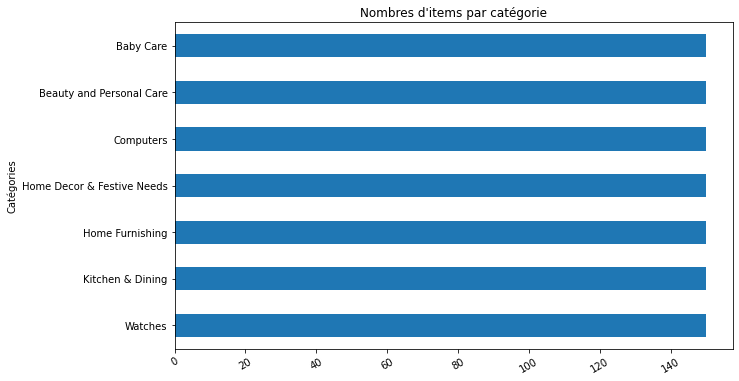

In [ ]:
plt.rcParams["figure.figsize"] = [10, 6]

df.value_counts(subset='category').plot(kind='barh')

plt.title("Nombres d'items par catégorie")
plt.ylabel('Catégories')
plt.xticks(rotation=30, horizontalalignment='center')

#### Description cleaning

* Remove **punctuation**
* **Tokenization** (token = word / = separate the words of the sentence into a set of words / go from a string to a list of strings = split the sentence into the set of words). 
  * the division into words of the different documents that make up the corpus (`word_tokenize` of `NLTKT`)
* Remove **stopwords** (with, and, or etc.) 
  * Normalization = construction of the dictionary which allows to ignore important local details (punctuation, capitalization, conjugation etc.)
* change to **lower case**
* **Lammetization/Stemming** 
  - *Stemming*: `PorterStemmer` keep only the root of the word (by truncation) - at the risk of losing the meaning  
  - *Lemmatization*: obtain the words in their canonical form (for a verb, it will be its infinitive / for a noun, its masculine singular form) - the objective is to keep only the meaning of the words used in the corpus

* Remove **words that appear frequently** (determiners, pronouns) (non-discriminating)
* Remove **alphanumeric codes** (price at the end of the description)

Let's download `NLTK` corpus reader : `stopwords` and `wordnet`. 
[Documentation](https://www.nltk.org/howto/wordnet.html)

In [ ]:
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


True

In [ ]:
ps = nltk.PorterStemmer()
lm = WordNetLemmatizer()
stopwords = nltk.corpus.stopwords.words('english')

def clean_text(text, ps=lm, stopwords=stopwords):
    text_lc = "".join([word.lower() for word in text if word not in string.punctuation]) # remove puntuation
    text_rc = re.sub('[0-9]+', '', text_lc) #remove numericals https://docs.python.org/3/library/re.html#re.sub 
    tokens = re.split('\W+', text_rc)    # tokenization
    text = [ps.lemmatize(word) for word in tokens if word not in stopwords and len(word) > 1]  # remove stopwords and lemmatizing
    return text

#### Most frequent tokens

In [ ]:
from collections import Counter

cnt = Counter()
for text in df['text'].apply(clean_text).values:
    for word in text:
        cnt[word] += 1
        
cnt.most_common(30)

[('r', 914),
 ('product', 863),
 ('cm', 677),
 ('free', 616),
 ('buy', 582),
 ('replacement', 568),
 ('delivery', 567),
 ('genuine', 564),
 ('shipping', 564),
 ('cash', 564),
 ('price', 559),
 ('day', 555),
 ('mug', 525),
 ('watch', 506),
 ('flipkartcom', 472),
 ('guarantee', 471),
 ('set', 437),
 ('baby', 414),
 ('feature', 403),
 ('online', 396),
 ('analog', 382),
 ('color', 370),
 ('cotton', 341),
 ('pack', 331),
 ('type', 324),
 ('girl', 313),
 ('showpiece', 312),
 ('material', 307),
 ('box', 305),
 ('ceramic', 295)]

#### Less frequent tokens

In [ ]:
n_rare_words = 20
set([w for (w, wc) in cnt.most_common()[:-n_rare_words-1:-1]])

{'amplifies',
 'apron',
 'aura',
 'cleaningreiki',
 'clockwise',
 'deeper',
 'disintegrates',
 'disintegrating',
 'femalesspecifications',
 'homeclinics',
 'hospitalnursing',
 'intention',
 'main',
 'negativity',
 'operate',
 'played',
 'rotate',
 'vastu',
 'vshaped',
 'wave'}

### Encoding - Bag of words

####Cleaning Functions

In [ ]:
ps = nltk.PorterStemmer()
lm = WordNetLemmatizer()
stopwords = nltk.corpus.stopwords.words('english')

def preprocessor(text):
    text_lc = "".join([word.lower() for word in text if word not in string.punctuation]) # remove puntuation
    text_rc = re.sub('[0-9]+', '', text_lc) #remove numericals
    return text_rc

def tokenizer(text, ps=lm, stopwords=stopwords):
    tokens = re.split('\W+', text)    # tokenization
    text = [ps.lemmatize(word) for word in tokens if word not in stopwords and len(word) > 1]  # remove stopwords and lemmatization
    return text

def tsne(dim, data, hue):
  tsne = TSNE(dim)
  components = tsne.fit_transform(data)
  plt.figure(figsize=(10, 10))
  sns.scatterplot(x=components[:,0], y=components[:,1], hue=hue)

def eval_ari(X, y, nb_cluster=7):
    kmeans = KMeans(n_clusters=7, random_state=666) #n_cluster = number of categories
    kmeans.fit(X)
    return adjusted_rand_score(kmeans.labels_, y)

Reminder : The Rand Index computes a similarity measure between two clusterings by considering all pairs of samples and counting pairs that are assigned in the same or different clusters in the predicted and true clusterings.
[Documentation](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.adjusted_rand_score.html)

#### `CountVectorizer`

= count the number of times a word comes back in the sentence for the whole corpus. This gives us a frequency vector. 

=> There is a parameter in countVectorizer which allows to remove the too frequent words.

We often obtain a sparse matrix (where there are more 0 than values)
Size of our matrix (number of rows = 1000 because 1000 items / but nb of columns to be defined regarding the number of different words of each description)

**Co-occurrences** (bi-trigrams) : words are often more representative of a context when they are associated by combination (of 2 or 3):    
  - co-occurrence (cf [Probability and Information Theory](https://colab.research.google.com/github/adhiraiyan/DeepLearningWithTF2.0/blob/master/notebooks/03.00-Probability-and-Information-Theory.ipynb#scrollTo=GHCMceBJDWZ8)) : $$\color{orange}{P(\mathrm{x} = x \ | \ \mathrm{y} = y) = \frac{P( x \cap y)}{P(y)} \tag{3b}}$$

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

countVectorizer = CountVectorizer(preprocessor=preprocessor,
                                  tokenizer=tokenizer, 
                                  ngram_range=(1, 2), #bigramm analysis
                                  max_df=0.4, #ignore too frequent words (frequency strictly above threshold)
                                  min_df=2) #ignore words that have an occurence strictly lower than 2

bag = countVectorizer.fit_transform(df['text'])
bag

<1050x6031 sparse matrix of type '<class 'numpy.int64'>'
	with 48101 stored elements in Compressed Sparse Row format>

In [ ]:
bag.shape

(1050, 6031)

tSNE = Method for visualizing high dimensional data.

The algo tSNE allows to visualize in 2 or 3 dimensions the vector of great dimensions. 


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


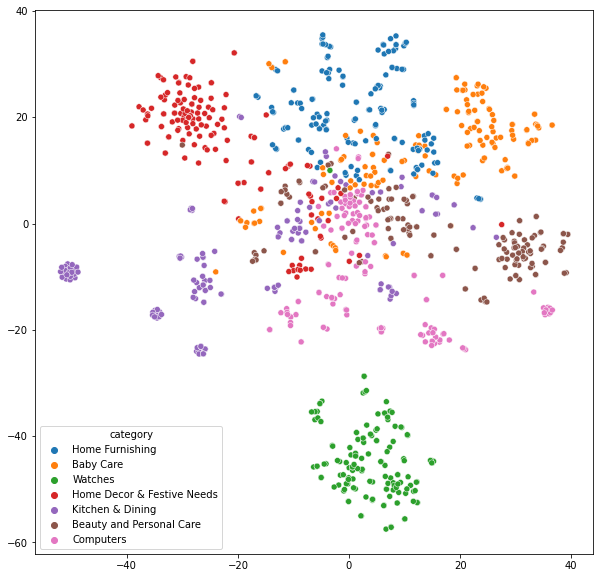

In [ ]:
tsne(2, bag, df['category'])

In [ ]:
eval_ari(bag, df['category'])

0.18555672852742366

#### `TF-IDF Vectorizer`


In [ ]:
tfidfVectorizer = TfidfVectorizer(preprocessor=preprocessor,
                                  tokenizer=tokenizer,
                                  max_df=0.4, 
                                  min_df=2) 
bag_tfidf = tfidfVectorizer.fit_transform(df['text'])
bag_tfidf

<1050x2123 sparse matrix of type '<class 'numpy.float64'>'
	with 24404 stored elements in Compressed Sparse Row format>

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


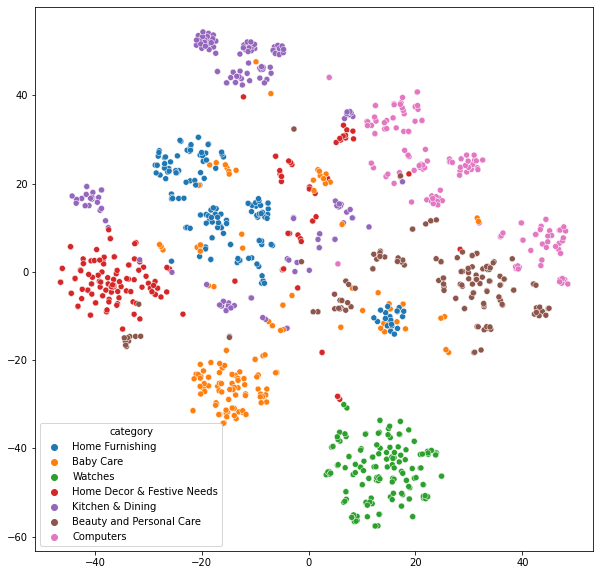

In [ ]:
tsne(2, bag_tfidf, df['category'])

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


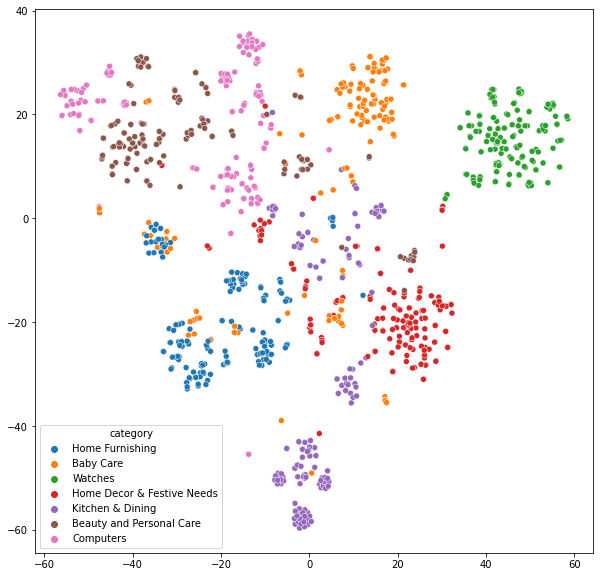

In [ ]:
tsne = TSNE(2)
components = tsne.fit_transform(bag_tfidf)

plt.figure(figsize=(10, 10))
sns.scatterplot(x=components[:,0], y=components[:,1], hue=df['category'])

In [ ]:
eval_ari(bag_tfidf,df['category'])

0.2684144236479604

In [ ]:
#l'ACP est une méthode apprise (donc si on re-applique la méthode sur une autre source de données, elle sera traitée uniformément)
#a l'inverser, tSNE : est une méthode de visualisation (n'a pas pour but de réduire les dimensions). Ne peut pas être ré-utilisé sur des nouvelles données. Cela permet seulement de visualiser. 

### Classification 

As we obtained best results on tf-idf classification, we will test performance of several classifiers on tf-idf bag of words : 

####Logistic Regression

In [ ]:
type(bag_tfidf.todense())

numpy.matrix

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(bag_tfidf.todense(), 
                                                    df['category'], 
                                                    test_size=0.2, 
                                                    random_state=666)

scaler = StandardScaler()

X_train_std = scaler.fit_transform(X_train)
X_test_std = scaler.transform(X_test)

model = LogisticRegression()

#hparams
params = {'C': [0.005, 0.01, 0.5]                    #Inverse of regularization strength. Smaller values specify stronger regularization.
         }

clf = GridSearchCV(model, params)
clf.fit(X_train_std, y_train)

print(f'Best Hyperparam(s) :{clf.best_params_}')
print(f'Test set / Best estimator : {clf.best_estimator_.score}') 
print(f'Test set / Score : {clf.score(X_test_std, y_test)}')
print(f'Train set / Score : {clf.score(X_train_std, y_train)}')

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:590: FutureWarning: np.matrix usage is deprecated in 1.0 and will raise a TypeError in 1.2. Please convert to a numpy array with np.asarray. For more information see: https://numpy.org/doc/stable/reference/generated/numpy.matrix.html
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:590: FutureWarning: np.matrix usage is deprecated in 1.0 and will raise a TypeError in 1.2. Please convert to a numpy array with np.asarray. For more information see: https://numpy.org/doc/stable/reference/generated/numpy.matrix.html
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:590: FutureWarning: np.matrix usage is deprecated in 1.0 and will raise a TypeError in 1.2. Please convert to a numpy array with np.asarray. For more information see: https://numpy.org/doc/stable/reference/generated/numpy.matrix.html
  FutureWarning,


Best Hyperparam(s) :{'C': 0.01}
Test set / Best estimator : <bound method ClassifierMixin.score of LogisticRegression(C=0.01)>
Test set / Score : 0.9523809523809523
Train set / Score : 0.9964285714285714


Evaluation metric : 
`ClassifierMixin.score` Returns the mean accuracy on the given test data and labels.

In multi-label classification, this is the subset accuracy which is a harsh metric since you require for each sample that each label set be correctly predicted.

To detect overfitting :    
- We compared scores obtained on training set and testing set ; 
- we will compare scores obtained on a baseline model. 

In [ ]:
from sklearn.dummy import DummyClassifier

Attention : On est ici dans un problème de classification. On prédit donc une proba d'appartenance à une catégorie. (et non pas un problème de régression !)


In [ ]:
#Baseline
X_train, X_test, y_train, y_test = train_test_split(bag_tfidf.todense(), 
                                                    df['category'], 
                                                    test_size=0.2, 
                                                    random_state=666)

scaler = StandardScaler()

X_train_std = scaler.fit_transform(X_train)
X_test_std = scaler.transform(X_test)

model = DummyClassifier(strategy="most_frequent")

#hparams
params = {}

clf = GridSearchCV(model, params)
clf.fit(X_train_std, y_train)

print(f'Best Hyperparam(s) :{clf.best_params_}')
print(f'Test set / Best estimator : {clf.best_estimator_.score}') 
print(f'Test set / Score : {clf.score(X_test_std, y_test)}')
print(f'Train set / Score : {clf.score(X_train_std, y_train)}')

Best Hyperparam(s) :{}
Test set / Best estimator : <bound method DummyClassifier.score of DummyClassifier(strategy='most_frequent')>
Test set / Score : 0.1
Train set / Score : 0.15357142857142858


/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:590: FutureWarning: np.matrix usage is deprecated in 1.0 and will raise a TypeError in 1.2. Please convert to a numpy array with np.asarray. For more information see: https://numpy.org/doc/stable/reference/generated/numpy.matrix.html
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:590: FutureWarning: np.matrix usage is deprecated in 1.0 and will raise a TypeError in 1.2. Please convert to a numpy array with np.asarray. For more information see: https://numpy.org/doc/stable/reference/generated/numpy.matrix.html
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:590: FutureWarning: np.matrix usage is deprecated in 1.0 and will raise a TypeError in 1.2. Please convert to a numpy array with np.asarray. For more information see: https://numpy.org/doc/stable/reference/generated/numpy.matrix.html
  FutureWarning,


Feasability : Very good performance on supervised clustering. No sign of overfitting have been detected (performance of baseline model weak as expected + decrease of score between training set and testing set). 



## Image Analysis

### ORB

![](https://drive.google.com/uc?export=view&id=1LDIcLSaDKM3q55VfEH0MTU8Trc8SN-au)

#### Explore Image Dataset

- Each photo is labelled from the name of the category

In [ ]:
df.groupby("category").count()

,text,image
category,,
Baby Care,150,150
Beauty and Personal Care,150,150
Computers,150,150
Home Decor & Festive Needs,150,150
Home Furnishing,150,150
Kitchen & Dining,150,150
Watches,150,150


In [ ]:
nb = df.shape[0]
dim = df.shape[1]

print(f'{nb} images with {dim} dimensions.')

1050 images with 3 dimensions.


In [ ]:
df.head()

,text,image,category
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing
1,Sathiyas Cotton Bath Towel Specifications of S...,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care
2,Eurospa Cotton Terry Face Towel Set Key Featur...,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care
3,SANTOSH ROYAL FASHION Cotton Printed King size...,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing
4,Jaipur Print Cotton Floral King sized Double B...,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing


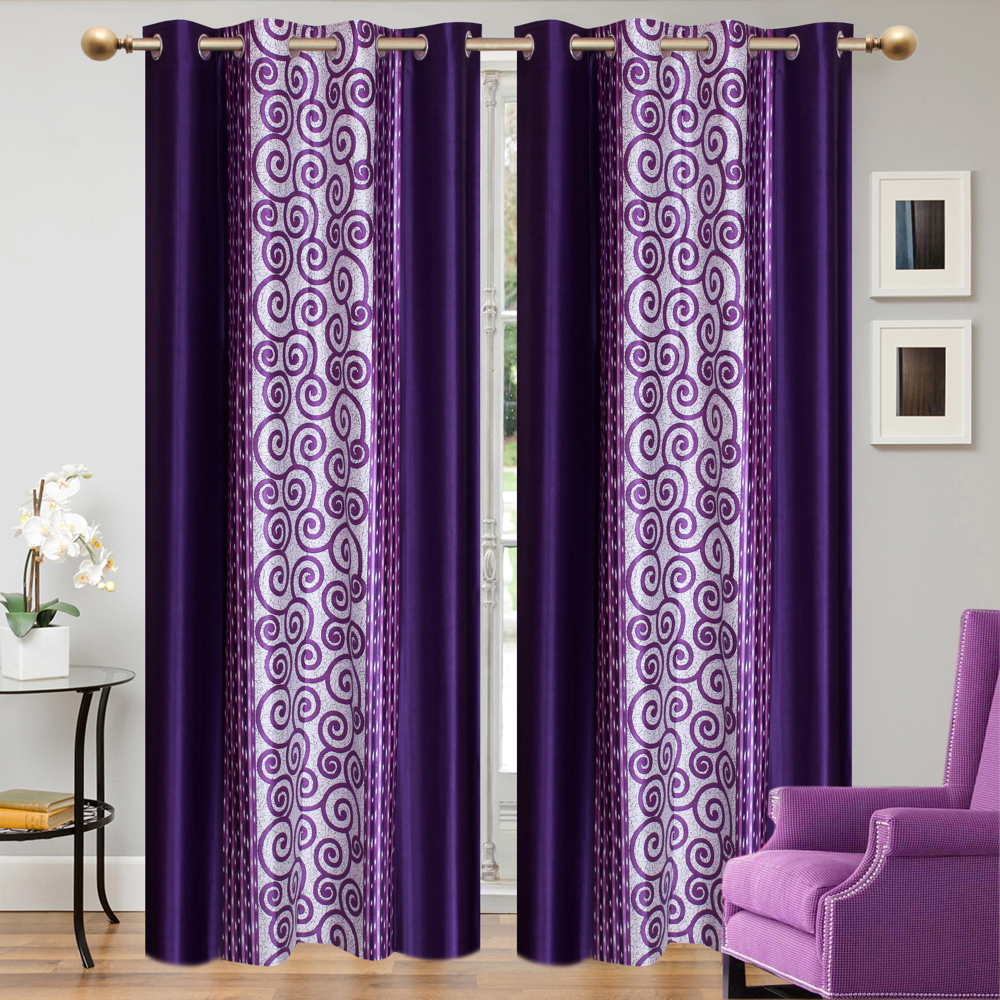

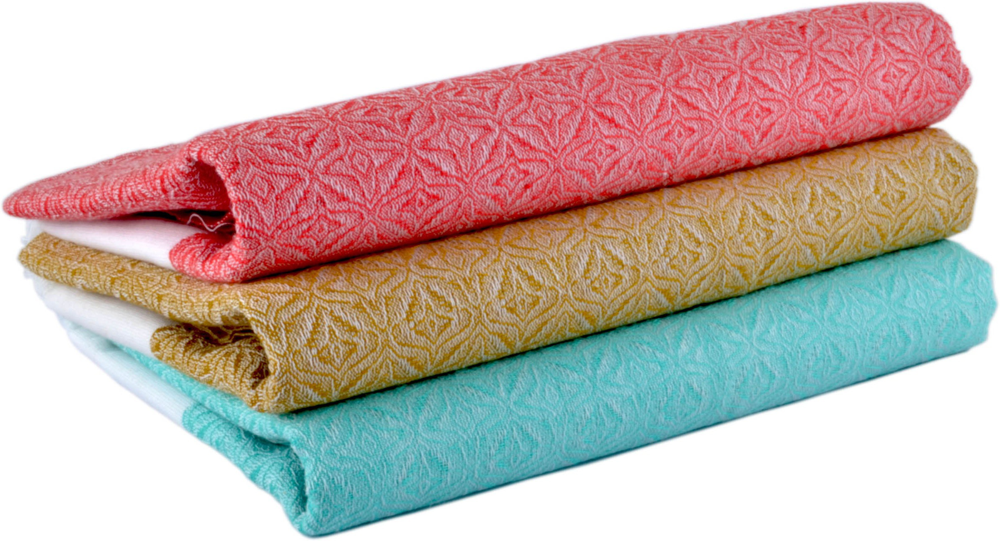

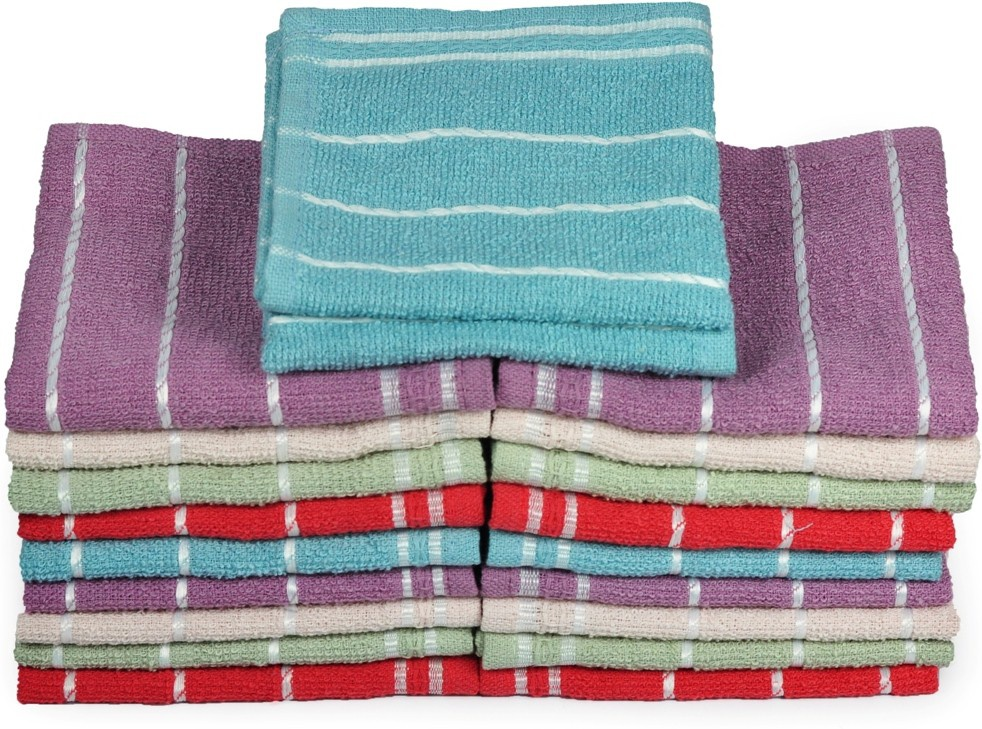

In [ ]:
for i in range(3):
    image, category = df.iloc[i, 1:]
    img_array = cv2.imread(os.path.join('/content/drive/MyDrive/Colab Notebooks/3_Projets OC/Projet 6/raw_data/Images', image)) 
    cv2_imshow(img_array)

Pictures are big, and of different sizes. We shall resize them during pre-processing. 
Let's print a sample for each category : 


Home Furnishing


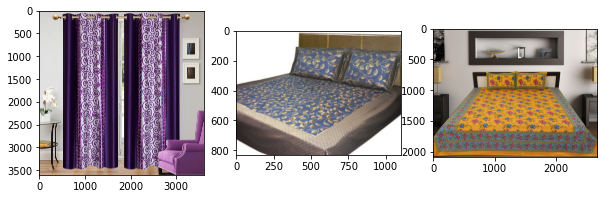

Baby Care


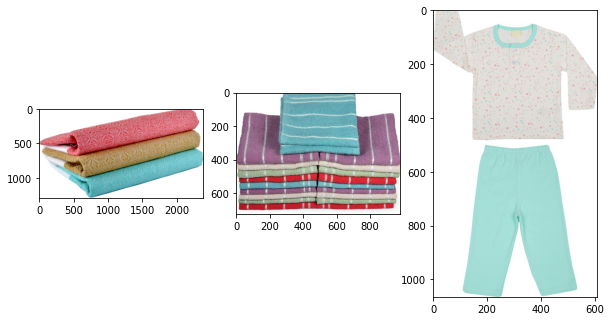

Watches


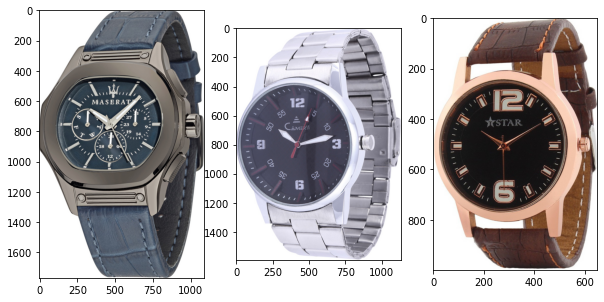

Home Decor & Festive Needs


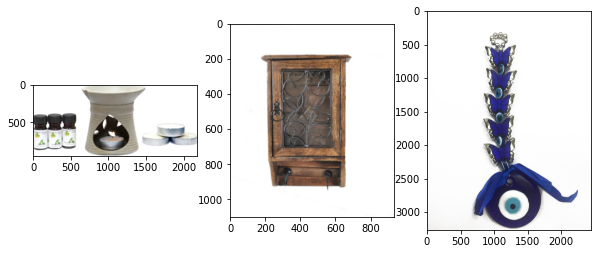

Kitchen & Dining


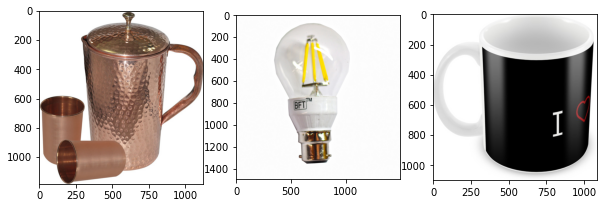

Beauty and Personal Care


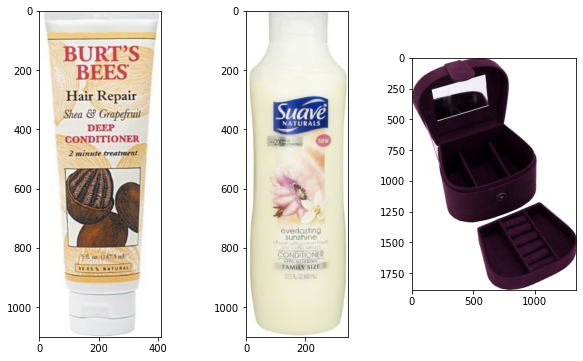

Computers


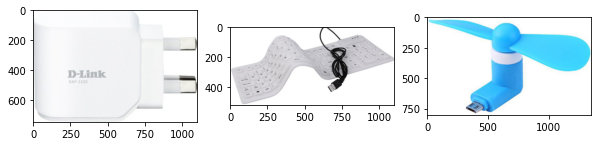

In [ ]:
from matplotlib.image import imread

path = '/content/drive/MyDrive/Colab Notebooks/3_Projets OC/Projet 6/raw_data/Images/'

#obtain list of categories
categ_list = list(df['category'].unique())

#obtain name of image for chosen categ

def img_name(categ):
  name = [df.iloc[i, 1] for i in range(df.shape[0]-1) if df['category'][i]==categ]
  return name

#for each category print category name and 3 resized images
for categ in categ_list:
  print(categ)
  for i in range(3):
      plt.subplot(130 + 1 + i)
      filename = path + img_name(categ)[i]
      image = imread(filename)
      plt.imshow(image)
  plt.show()

#### Show descriptors samples

Home Furnishing


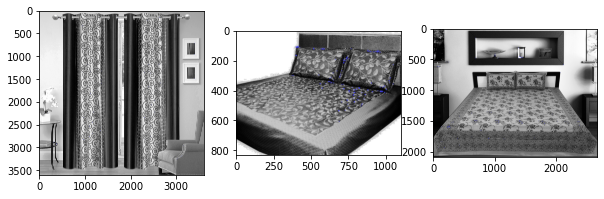

Descripteurs :  (200, 32)

[[127 124 240 ... 247  26  18]
 [ 79 147 177 ...  38 135 119]
 [203  25  51 ... 108  36  94]
 ...
 [253  48  69 ... 227  82  49]
 [220 166 172 ... 112  61  82]
 [ 73 244  57 ... 114 194  59]]
Baby Care


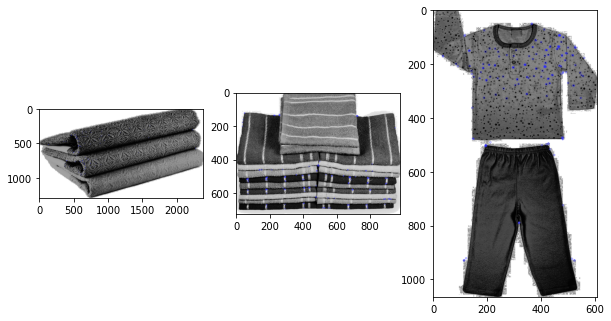

Descripteurs :  (200, 32)

[[253  73 110 ... 191 114 241]
 [186  65 102 ... 159  96 209]
 [119 112 178 ...  55  43  87]
 ...
 [106 164 144 ...  68 143 143]
 [202 192  54 ...  12 125  78]
 [129  77 223 ... 216 233 108]]
Watches


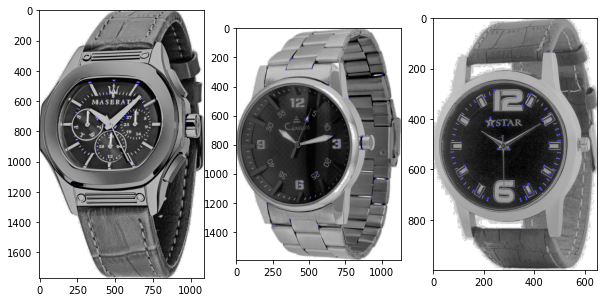

Descripteurs :  (200, 32)

[[ 34  50 113 ... 128  70 181]
 [ 73 100 234 ... 242   3  97]
 [156 244 157 ... 122 135 243]
 ...
 [196 177 157 ...  98 131  34]
 [ 47 191  98 ...  14  90 205]
 [116 227 105 ... 187  94  17]]
Home Decor & Festive Needs


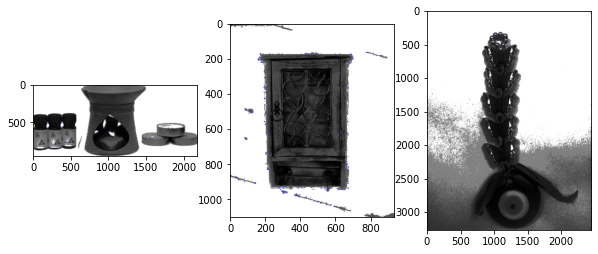

Descripteurs :  (200, 32)

[[120 169 154 ...   0 206  42]
 [ 64 184 153 ... 128   7  56]
 [190  40  97 ... 173  94 246]
 ...
 [107 123 116 ... 183  74 125]
 [253 124  28 ...  63  90   2]
 [239 108  98 ... 183 114 212]]
Kitchen & Dining


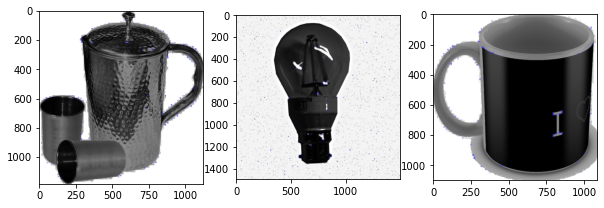

Descripteurs :  (200, 32)

[[  8 114  47 ... 132  46 247]
 [144 172 206 ...  72 242 130]
 [ 48  32 134 ...   2  34 128]
 ...
 [248 244 188 ...  64 230  27]
 [125 101 253 ... 251  66  33]
 [ 78 185 180 ...  34   3 139]]
Beauty and Personal Care


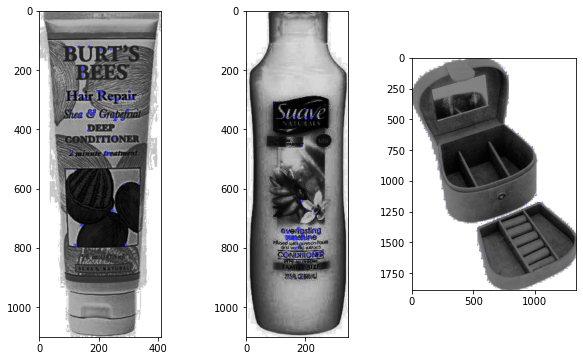

Descripteurs :  (200, 32)

[[138 150 247 ... 220 229 251]
 [244 238 142 ... 123 170 130]
 [178  23 162 ... 125 251 134]
 ...
 [164 172 198 ... 105 227 136]
 [  2 141   2 ...  90 241 138]
 [ 22 173 214 ... 123 177 136]]
Computers


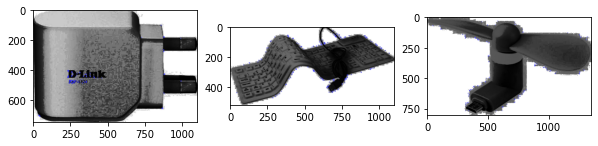

Descripteurs :  (200, 32)

[[  7  13  66 ... 219 176 172]
 [173 244 188 ... 251  66 163]
 [221 188 156 ... 245 139  27]
 ...
 [ 86 205 132 ... 122 176   8]
 [166 205 132 ... 123 176 128]
 [ 36 164 198 ... 104 114 136]]


In [ ]:
#for each category print category name and 3 resized images and their keypoints
for categ in categ_list:
  print(categ)
  for i in range(3):
      plt.subplot(130 + 1 + i)
      orb = cv2.ORB_create(nfeatures=200) #maximum n feature to retain
      filename = path + img_name(categ)[i]
      img_array = cv2.imread(filename,0) # convert in gray
      img_array = cv2.equalizeHist(img_array)   # equalize image histogram

      kp, des = orb.detectAndCompute(img_array, None)

      img=cv2.drawKeypoints(img_array, #input array
                            kp, #keypoints 
                            img_array, #output array
                            color=(51, 51, 255), #keypoint color
                            flags=0 #DEFAULT
                            )
      plt.imshow(img)
  plt.show()
  print("Descripteurs : ", des.shape)
  print()
  print(des)

Home Furnishing


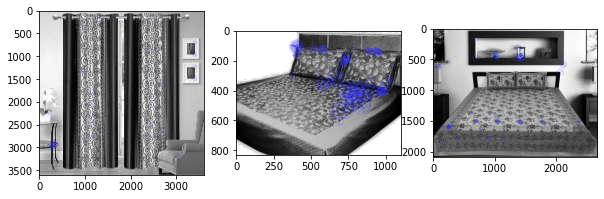

Descripteurs :  (200, 32)

[[127 124 240 ... 247  26  18]
 [ 79 147 177 ...  38 135 119]
 [203  25  51 ... 108  36  94]
 ...
 [253  48  69 ... 227  82  49]
 [220 166 172 ... 112  61  82]
 [ 73 244  57 ... 114 194  59]]
Baby Care


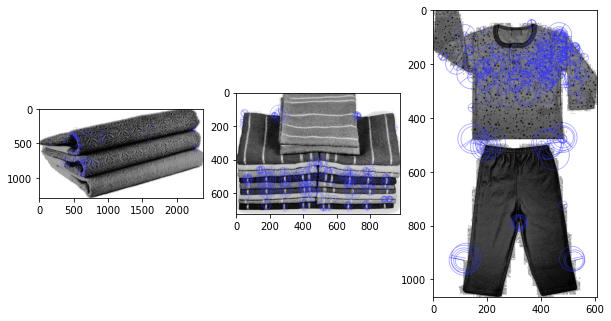

Descripteurs :  (200, 32)

[[253  73 110 ... 191 114 241]
 [186  65 102 ... 159  96 209]
 [119 112 178 ...  55  43  87]
 ...
 [106 164 144 ...  68 143 143]
 [202 192  54 ...  12 125  78]
 [129  77 223 ... 216 233 108]]
Watches


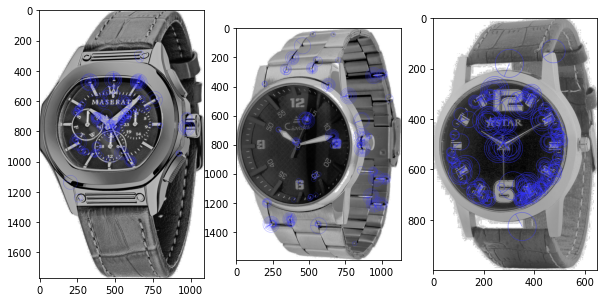

Descripteurs :  (200, 32)

[[ 34  50 113 ... 128  70 181]
 [ 73 100 234 ... 242   3  97]
 [156 244 157 ... 122 135 243]
 ...
 [196 177 157 ...  98 131  34]
 [ 47 191  98 ...  14  90 205]
 [116 227 105 ... 187  94  17]]
Home Decor & Festive Needs


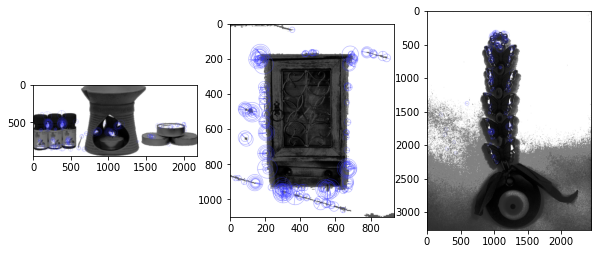

Descripteurs :  (200, 32)

[[120 169 154 ...   0 206  42]
 [ 64 184 153 ... 128   7  56]
 [190  40  97 ... 173  94 246]
 ...
 [107 123 116 ... 183  74 125]
 [253 124  28 ...  63  90   2]
 [239 108  98 ... 183 114 212]]
Kitchen & Dining


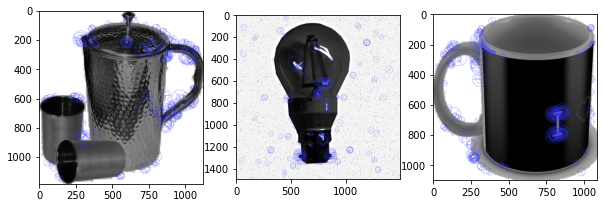

Descripteurs :  (200, 32)

[[  8 114  47 ... 132  46 247]
 [144 172 206 ...  72 242 130]
 [ 48  32 134 ...   2  34 128]
 ...
 [248 244 188 ...  64 230  27]
 [125 101 253 ... 251  66  33]
 [ 78 185 180 ...  34   3 139]]
Beauty and Personal Care


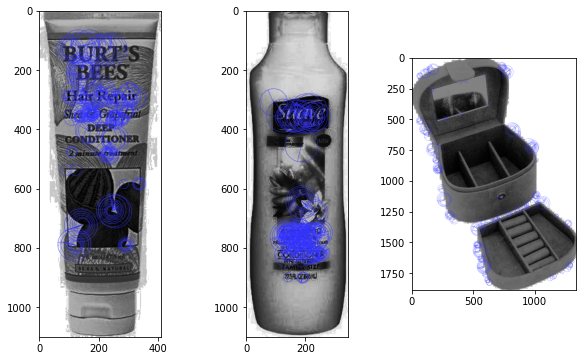

Descripteurs :  (200, 32)

[[138 150 247 ... 220 229 251]
 [244 238 142 ... 123 170 130]
 [178  23 162 ... 125 251 134]
 ...
 [164 172 198 ... 105 227 136]
 [  2 141   2 ...  90 241 138]
 [ 22 173 214 ... 123 177 136]]
Computers


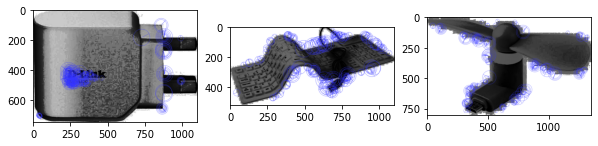

Descripteurs :  (200, 32)

[[  7  13  66 ... 219 176 172]
 [173 244 188 ... 251  66 163]
 [221 188 156 ... 245 139  27]
 ...
 [ 86 205 132 ... 122 176   8]
 [166 205 132 ... 123 176 128]
 [ 36 164 198 ... 104 114 136]]


In [ ]:
#Show size and orientation of keypoints
for categ in categ_list:
  print(categ)
  for i in range(3):
      plt.subplot(130 + 1 + i)
      orb = cv2.ORB_create(nfeatures=200) #maximum n feature to retain
      filename = path + img_name(categ)[i]
      img_array = cv2.imread(filename,0) # convert in gray
      img_array = cv2.equalizeHist(img_array)   # equalize image histogram

      kp, des = orb.detectAndCompute(img_array, None)

      img=cv2.drawKeypoints(img_array, #input array
                            kp, #keypoints 
                            img_array, #output array
                            color=(51, 51, 255), #keypoint color
                            flags=4 #DEFAULT
                            )
      plt.imshow(img)
  plt.show()
  print("Descripteurs : ", des.shape)
  print()
  print(des)

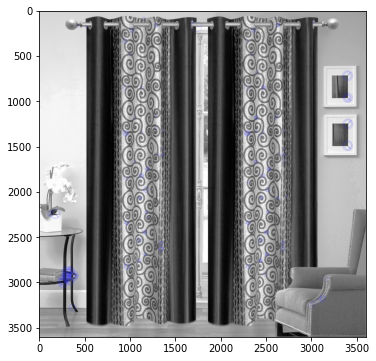

Descripteurs :  (200, 32)

[[ 57 188  30 ... 208 235 155]
 [ 29 149  63 ... 192 238  99]
 [207 252  46 ... 245 227 115]
 ...
 [ 56 253  58 ...   2 230 187]
 [185  93 110 ... 171 120  16]
 [243  33  98 ...  14 122 198]]


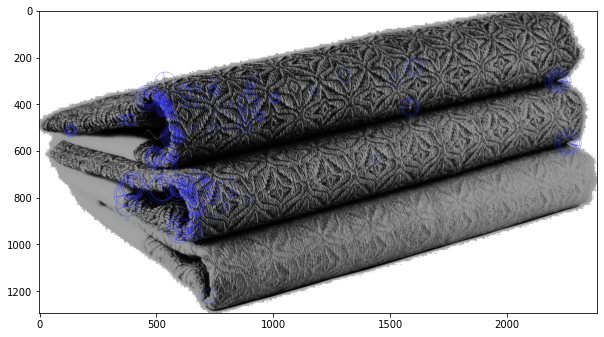

Descripteurs :  (200, 32)

[[  1 167  59 ... 139 131 225]
 [210 143  31 ...  32 167 233]
 [107  12 236 ... 229  86  98]
 ...
 [ 60  91  83 ... 187 106 177]
 [ 34 189  48 ...  76 135 158]
 [ 56  86  27 ...  91 174 195]]


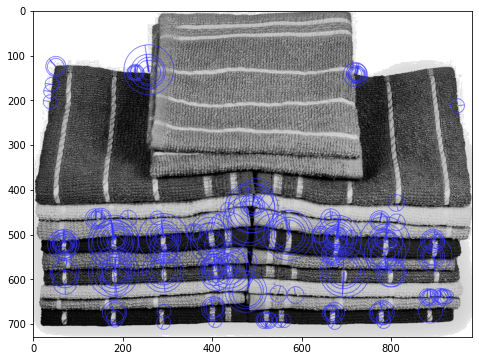

Descripteurs :  (200, 32)

[[ 44  50 216 ... 251 107 131]
 [221  87 111 ... 179 113 113]
 [186  81 102 ...  46 119 223]
 ...
 [ 66 164 150 ...  68 167  75]
 [ 67  32 245 ... 133   3 173]
 [ 67  32 245 ... 133  67 173]]


In [ ]:
for i in range(3):
  orb = cv2.ORB_create(nfeatures=200) #maximum n feature to retain

  img_array = cv2.imread(os.path.join('/content/drive/MyDrive/Colab Notebooks/3_Projets OC/Projet 6/raw_data/Images', 
                                  df.iloc[i, 1]),
                                  0) # convert in gray
  img_array = cv2.equalizeHist(img_array)   # equalize image histogram

  kp, des = orb.detectAndCompute(img_array, None)

  img=cv2.drawKeypoints(img_array, #input array
                        kp, #keypoints 
                        img_array, #output array
                        color=(51, 51, 255), #keypoint color
                        flags=4 #DRAW_RICH_KEYPOINTS
                        )
  plt.imshow(img)
  plt.show()
  print("Descripteurs : ", des.shape)
  print()
  print(des)

#### Features extraction 

* For each image, gray scale and equalization
* creation of a list of descriptors for all the images ("flat_descriptors") which will be used to create the descriptor clusters

In [ ]:
path = "/content/drive/MyDrive/Colab Notebooks/3_Projets OC/Projet 6/raw_data/Images"
list_photos = [file for file in listdir(path)]
print(len(list_photos))

1050


In [ ]:
descriptors = {}
N = df.shape[0]

for i in range(df.shape[0]):
    image, category = df.iloc[i, 1:]
    img_array = cv2.imread(os.path.join('/content/drive/MyDrive/Colab Notebooks/3_Projets OC/Projet 6/raw_data/Images', image)) 
    
    #rezising of the image (to boost running time)
    x_size = 1024
    y_size = round((img_array.shape[1]*x_size)/img_array.shape[0])
    img_array = cv2.resize(img_array, (x_size, y_size), interpolation = cv2.INTER_CUBIC)

    #level of gray 
    img_array = cv2.cvtColor(img_array, cv2.COLOR_BGR2GRAY)
    
    #equalization
    img_array = cv2.equalizeHist(img_array)
    
    #ORB = SIFT but Opensource
    orb = cv2.ORB_create(nfeatures=200)
    kp, des = orb.detectAndCompute(img_array,None) #get key points and descriptors

    descriptors.update({i:des}) #store descriptors in the dictionnary
    if i > N:
        break

flat_descriptors = np.concatenate(list(descriptors.values()), axis=0)

#### Clustering descriptors

- Using MiniBatchKMeans to achieve reasonable processing times

In [ ]:
#MiniKmeans params
num_clusters = 128
batch_size = 256

#clustering
kmeans = MiniBatchKMeans(n_clusters=num_clusters, batch_size=batch_size, random_state=0).fit(flat_descriptors)

#### Bag of visual words (BOVW)

Visual bag of words = creating features for each image. 
Features of an image = Histogram of an image = Count for an image of the number of descriptors per cluster.

- For each image :    
  - prediction of the cluster numbers of each descriptor
  - creation of a histogram = counting for each cluster number the descriptors in the image

In [ ]:
freq = []
for i in range(df.shape[0]):
    visual_words = kmeans.predict(descriptors[i])

    hist = np.zeros(num_clusters)
    for v in visual_words:
        hist[v] += 1.0

    freq.append(hist)
    if i > N:
        break

freq_array = np.stack(freq, axis=0)

In [ ]:
freq_array.shape

(1050, 128)

#### Dimensionality Reduction (PCA)

In [ ]:
from sklearn.decomposition import PCA

#on passe d'un descripteur de taille 16 à un descripteur de taille 128
pca = PCA(16)
pca_features = pca.fit_transform(freq_array)

In [ ]:
eval_ari(pca_features, df['category'].iloc[:N+2])

0.023283711308553886

#### TSNE

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


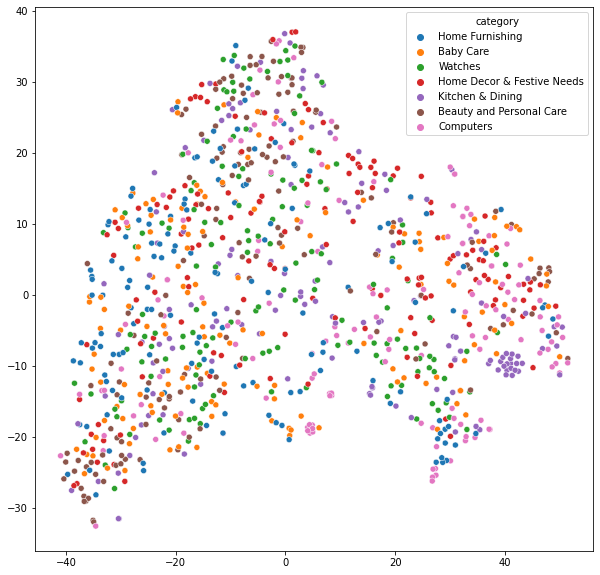

In [ ]:
from sklearn.manifold import TSNE

tsne = TSNE(2)
components = tsne.fit_transform(pca_features)

plt.figure(figsize=(10, 10))
sns.scatterplot(x=components[:,0], y=components[:,1], hue=df['category'].iloc[:N+2])

#### Classification

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(pca_features, 
                                                    df['category'], 
                                                    test_size=0.2, 
                                                    random_state=666)

scaler = StandardScaler()

X_train_std = scaler.fit_transform(X_train)
X_test_std = scaler.transform(X_test)

model = LogisticRegression()

#hparams
params = {'C': [0.1, 0.2, 0.5]                    #Inverse of regularization strength. Smaller values specify stronger regularization.
         }

clf = GridSearchCV(model, params)
clf.fit(X_train_std, y_train)

print(f'Best Hyperparam(s) :{clf.best_params_}')
print(f'Test set / Best estimator : {clf.best_estimator_.score}') 
print(f'Test set / Score : {clf.score(X_test_std, y_test)}')
print(f'Train set / Score : {clf.score(X_train_std, y_train)}')

Best Hyperparam(s) :{'C': 0.5}
Test set / Best estimator : <bound method ClassifierMixin.score of LogisticRegression(C=0.5)>
Test set / Score : 0.2857142857142857
Train set / Score : 0.35833333333333334


CCL : Low performance of the SIFT algorithm application on visual recognition. 

### CNN

#### Stratified sample

In [ ]:
def stratified_sample_df(df, col, n_samples):
    n = min(n_samples, df[col].value_counts().min())
    df_ = df.groupby(col).apply(lambda x: x.sample(n))
    df_.index = df_.index.droplevel(0)
    return df_

subsampled_df = stratified_sample_df(df, 'category', 500)

#### EfficientNetB0

In [ ]:
# from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications import EfficientNetB7


# model = EfficientNetB0(include_top=False, weights='imagenet', pooling='avg')
model = EfficientNetB7(include_top=False, 
                       weights='imagenet', #weights pre-trained on ImageNet
                       pooling='avg') # global average pooling will be applied to the output of the last convolutional layer


258088960/258076736 [==============================] - 2s 0us/step


In [ ]:
subsampled_df.head()

,text,image,category
845,Feetje Trousers Feetje Trousers - Buy Blue Fee...,9e90fb6c7870637b6f794e4b4c26bd7e.jpg,Baby Care
622,Mee Mee Multifunctional Nursery Diaper Bag Mee...,672d1c3272eae4586eb5994fe408c12a.jpg,Baby Care
1014,Toons Printed Baby Boy's Round Neck T-Shirt Ke...,721d6fc10f52e76007c3c0405cf967c5.jpg,Baby Care
904,Relaxfeel Floral Single Dohar White Key Featur...,a541b3aba326d7749b4c086c3cea9273.jpg,Baby Care
114,Lollipop Lane Tiddly Wink Safari Bath Set Flip...,bc784846bd59a16832454416ac708003.jpg,Baby Care


In [ ]:
features_list = []
images_list = []

for i in range(df.shape[0]):
    image, category = df.iloc[i, 1:]
    img_array = cv2.imread(os.path.join('/content/drive/MyDrive/Colab Notebooks/3_Projets OC/Projet 6/raw_data/Images', image)) 
    
    # x_size = 224
    # y_size = 224

    x_size = 600
    y_size = 600
    
    img_array = cv2.resize(img_array, (x_size, y_size), interpolation = cv2.INTER_CUBIC)

    im_feat = model(img_array).numpy()[0]
    features_list.append((i, im_feat))

#### TSNE

In [ ]:
features = [feat[1] for feat in features_list]
tsne = manifold.TSNE(n_components=2, init='pca', random_state=0)
X_tsne = tsne.fit_transform(np.stack(features))

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning: The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.
  FutureWarning,


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


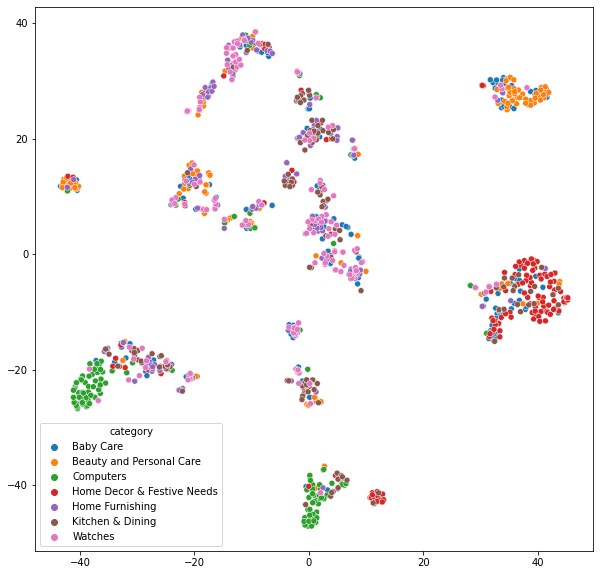

In [ ]:
categ = subsampled_df.iloc[:X_tsne.shape[0], 2]
tsne(2, X_tsne, categ)

#### Classification

##### RF

In [ ]:
#Split train test
X_train, X_test, y_train, y_test = train_test_split(np.stack(features), 
                                                    categ, 
                                                    test_size=0.2, 
                                                    random_state=666)

#Standardization
scaler = StandardScaler()

X_train_std = scaler.fit_transform(X_train)
X_test_std = scaler.transform(X_test)

#Dimensionality Reduction
pca = PCA(n_components=10)
pca.fit(X_train_std)

X_train_pca = pca.transform(X_train_std)
X_test_pca = pca.transform(X_test_std)

#hparams
params = {'max_depth': range(5, 20, 2)}
model = RandomForestClassifier(n_estimators=200, random_state=0)

clf = GridSearchCV(model, params)
clf.fit(X_train_pca, y_train)

print(f'Best Hyperparam(s) :{clf.best_params_}')
print(f'Test set / Best estimator : {clf.best_estimator_.score}') 
print(f'Test set / Score : {clf.score(X_test_pca, y_test)}')
print(f'Train set / Score : {clf.score(X_train_pca, y_train)}')

Best Hyperparam(s) :{'max_depth': 13}
Test set / Best estimator : <bound method ClassifierMixin.score of RandomForestClassifier(max_depth=13, n_estimators=200, random_state=0)>
Test set / Score : 0.5333333333333333
Train set / Score : 0.9952380952380953


CCL : CNN helps us improve the performance of the classification engine. The result being 0.5 the algorithm is wrong one time out of two. We should therefore add manual control to reinforce the quality of the classification. 

=> Axes d'amélioration : définir les catégories via une classification non supervisée (cf slides)
=> Puis problème supervisé
